# ENEL 645 - W2023
## Canis Familaris Breed Classifier
Group 4:  
Ayodele Oyelese  
Stewart Pratt  
Shawn Lee  
Nicolas Hirschfeld  
Nicholas Lor  
Tania So

# Introduction

We utilized PyTorch's Resnet50 model as our pretrained model as it is a quick model and has a good supply of dog features pre-trained. Our dataset is sourced from this Kaggle data set https://www.kaggle.com/datasets/gpiosenka/70-dog-breedsimage-data-set.

#Step 0: Required Imports

In [ ]:
import zipfile
import os

import torchvision.models as models
import torchvision.transforms as transforms
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import utils
from torchvision import datasets
from torch.utils.data import Dataset
from torchvision.datasets import ImageFolder
from sklearn.metrics import classification_report


import cv2 
import matplotlib as mpl               
import matplotlib.pyplot as plt 

import numpy as np   
from PIL import Image
from PIL import ImageFile

from skimage.io import imread
from skimage.transform import resize

#Step 1: Import Dataset

The data sets are saved directly on our gitHub Repository. 


 USING WGET. This module was run using wget to import the zip file containing the Dataset from our github repo.

In [ ]:
import zipfile
import os

!wget  --no-check-certificate \
"https://github.com/segpratt/ENEL-645-Project-Dog-Classifier/archive/refs/heads/main.zip" \
    -O "/tmp/ProjectDataSet.zip"

zip_ref = zipfile.ZipFile('/tmp/ProjectDataSet.zip', 'r') #Opens the zip file in read mode
zip_ref.extractall('/tmp') #Extracts the files into the /tmp folder
zip_ref.close()

--2023-04-02 22:47:29--  https://github.com/segpratt/ENEL-645-Project-Dog-Classifier/archive/refs/heads/main.zip
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/segpratt/ENEL-645-Project-Dog-Classifier/zip/refs/heads/main [following]
--2023-04-02 22:47:29--  https://codeload.github.com/segpratt/ENEL-645-Project-Dog-Classifier/zip/refs/heads/main
Resolving codeload.github.com (codeload.github.com)... 192.30.255.121
Connecting to codeload.github.com (codeload.github.com)|192.30.255.121|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘/tmp/ProjectDataSet.zip’

/tmp/ProjectDataSet     [ <=>                ] 215.83M  33.1MB/s    in 7.1s    

2023-04-02 22:47:36 (30.5 MB/s) - ‘/tmp/ProjectDataSet.zip’ saved [226311956]



In [ ]:
#Obtain the path where the dataset is stored
dataset_path = '/tmp/ENEL-645-Project-Dog-Classifier-main/DatasetAll'


In [ ]:
transform = transforms.Compose([transforms.ToTensor()])
dataset = ImageFolder(dataset_path, transform=transform)


#Step 2: Split data into train, val, test and inspect


In [ ]:
ImageFile.LOAD_TRUNCATED_IMAGES = True
# Specify Transforms for data augementation as well as Normalization and STD
# Used mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225] which specified in the pytorch Documentation for models using imagenet aka the Resnet model
# Convert to Tensor
# Used random flips as well as random cropping to data augment
torchvision_transform = transforms.Compose([transforms.Resize(256),
                                  transforms.RandomResizedCrop(224),
                                  transforms.RandomHorizontalFlip(),
                                  transforms.RandomRotation(10),
                                  transforms.ToTensor(),
                                  transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                       std=[0.229, 0.224, 0.225])])


torchvision_transform_test = transforms.Compose([transforms.Resize(256),
                                  transforms.CenterCrop(224),
                                  transforms.ToTensor(),
                                  transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                       std=[0.229, 0.224, 0.225])])

In [ ]:
from sklearn.model_selection import StratifiedShuffleSplit
from torch.utils.data import DataLoader, TensorDataset

# Create a list of labels
labels = [sample[1] for sample in dataset.samples]

# Use StratifiedShuffleSplit to split the data while preserving the class proportions
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_indices, test_val_indices = next(sss.split(dataset.samples, labels))
val_test_indices = test_val_indices[:len(test_val_indices)//2]
test_indices = test_val_indices[len(test_val_indices)//2:]

# Split the dataset using the indices
train_dataset = ImageFolder(dataset_path, transform=torchvision_transform)
val_dataset = ImageFolder(dataset_path, transform=torchvision_transform)
test_dataset = ImageFolder(dataset_path, transform=torchvision_transform_test)
train_dataset.samples = [train_dataset.samples[i] for i in train_indices]
train_dataset.targets = [train_dataset.targets[i] for i in train_indices]
val_dataset.samples = [val_dataset.samples[i] for i in val_test_indices]
val_dataset.targets = [val_dataset.targets[i] for i in val_test_indices]
test_dataset.samples = [test_dataset.samples[i] for i in test_indices]
test_dataset.targets = [test_dataset.targets[i] for i in test_indices]


In [ ]:
print(f"Number of classes in train set: {len(train_dataset.classes)}")
print(f"Number of classes in val set: {len(val_dataset.classes)}")
print(f"Number of classes in test set: {len(test_dataset.classes)}")
print("\n")
print(f"Number of images in train set: {len(train_dataset)}")
print(f"Number of images in val set: {len(val_dataset)}")
print(f"Number of images in test set: {len(test_dataset)}")

Number of classes in train set: 70
Number of classes in val set: 70
Number of classes in test set: 70


Number of images in train set: 7476
Number of images in val set: 935
Number of images in test set: 935


In [ ]:
import inspect

def getLabelFrequencies(dataset):
  label_freq = {}
  for _, label in dataset:
      if label in label_freq:
          label_freq[label] += 1
      else:
          label_freq[label] = 1

  fig, ax = plt.subplots()
  ax.bar(label_freq.keys(), label_freq.values())
  ax.set_xlabel("Label")
  ax.set_ylabel("Frequency")
  var_name = [k for k,v in inspect.currentframe().f_back.f_locals.items() if v is dataset][0]
  ax.set_title('Label frequencies in ' + var_name)
  return plt.show()

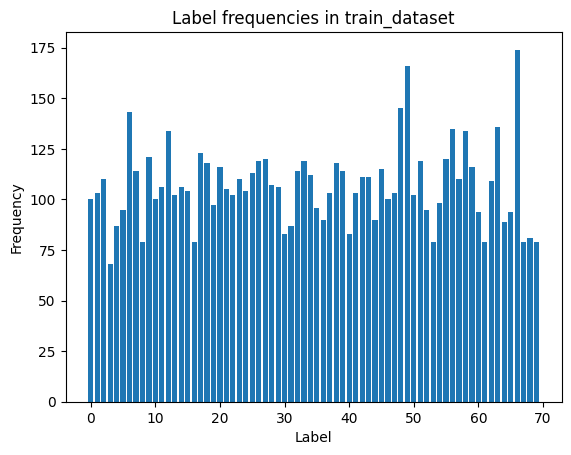

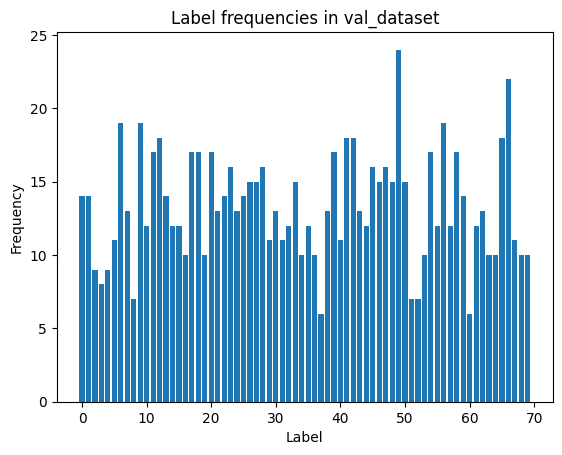

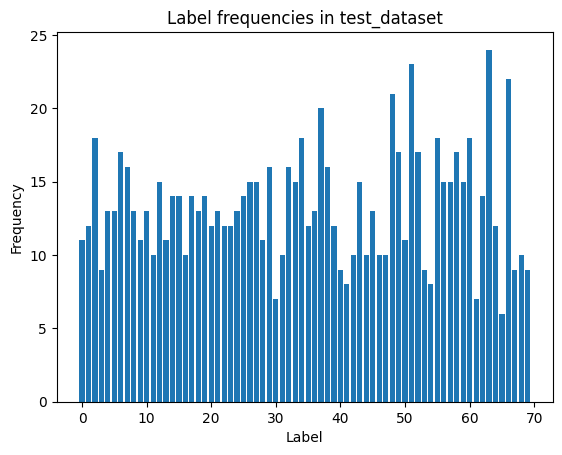

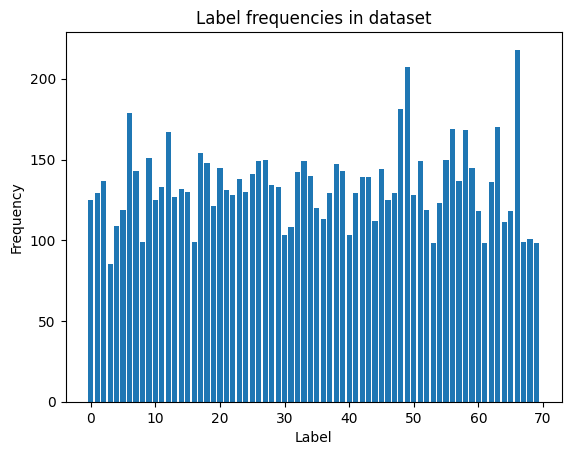

In [ ]:
getLabelFrequencies(train_dataset)
getLabelFrequencies(val_dataset)
getLabelFrequencies(test_dataset)
getLabelFrequencies(dataset)

#Step 3: Data Pre-processing

In [ ]:
# Specify Workers and batch size
workers = 0
b_size = 20

In [ ]:
# Create the data loaders
trainloader = torch.utils.data.DataLoader(train_dataset, batch_size= b_size, shuffle = True, num_workers= workers)
valloader = torch.utils.data.DataLoader(val_dataset, batch_size= b_size, num_workers= workers)
testloader = torch.utils.data.DataLoader(test_dataset, batch_size= b_size, num_workers= workers)

# Step 4: Inspect the images

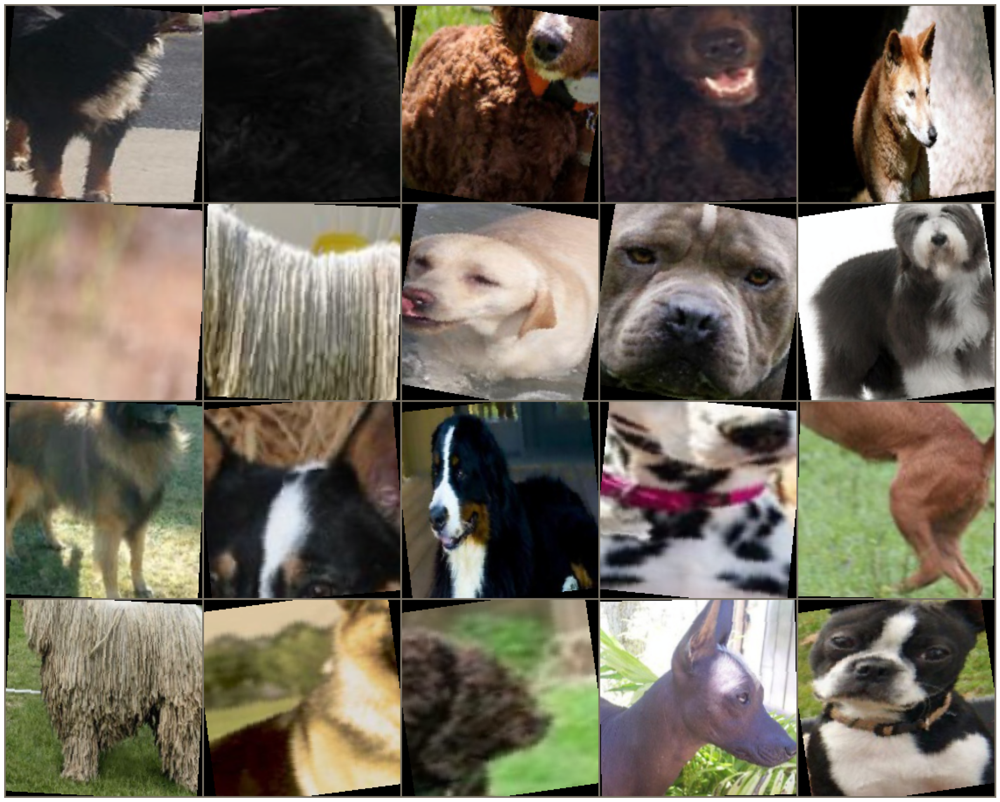

In [ ]:
                
%matplotlib inline                               

# Get some images to check the data set looks alright
def show_images(inp):
    inp = inp.numpy().transpose((1, 2, 0))
    inp = inp * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    inp = np.clip(inp, 0, 1)
    
    fig = plt.figure(figsize=(60, 25))
    plt.axis('off')
    plt.imshow(inp)
    plt.pause(0.001)
      
inputs, classes = next(iter(trainloader))

#Format style
grid = utils.make_grid(inputs, nrow=5)
show_images(grid)

#Step 5: Obtain Pre-Trained Resnet50 Model

In [ ]:
# Specify model architecture 
model = models.resnet50(pretrained=True)

# Freeze parameters in pre-trained model
for param in model.parameters():
    param.requires_grad = False

# Replace the last fully connected layer with a Linear layer 
# Linear layer has 70 out features
model.fc = nn.Linear(2048, 70)

# is CUDA available?
use_cuda = torch.cuda.is_available()

if use_cuda:
    model = model.cuda()


/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


#Step 6: Define Callbacks

In [ ]:
train_loss_history = []
val_loss_history = []
train_acc_history = []
val_acc_history = []

def train(n_epochs, train_loader, val_loader, model, optimizer, criterion, use_cuda, save_path, patience=5):
    """returns trained model"""
    # initialize tracker to find minimum validation loss
    validation_loss_minimum = np.Inf 
    # initialize counter for number of epochs with no improvement in validation loss
    patience_counter = 0
    # set the initial best validation loss to infinity
    best_validation_loss = np.Inf
    
    for epoch in range(1, n_epochs+1):
        # Initialize training and validation loss
        training_loss = 0.0
        train_correct = 0.0
        train_total = 0.0

        validation_loss = 0.0
        val_correct = 0
        val_total = 0

        # Train the model
        model.train()
        for batch_idx, (data, target) in enumerate(train_loader):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            # capture the loss and update the model parameters accordingly
            # record and update the average training_loss

            # clear the gradients (grad) of optimized variables
            # initialize weights to be zero
            optimizer.zero_grad()
            # forward pass
            output = model(data)
            # calculate loss (batch loss)
            loss = criterion(output, target)
            # backward pass
            loss.backward()
            # parameter update
            optimizer.step()
            # update training_loss
            training_loss += loss.item() * data.size(0)

            # predicted = torch.max(output.data, 1)
            # train_total += target.size(0)
            # train_correct += (predicted == target).sum().item()
            # convert output probabilities to predicted class
            predicted = output.data.max(1, keepdim=True)[1]
            # compare predictions to true label
            train_correct += np.sum(np.squeeze(predicted.eq(target.data.view_as(predicted))).cpu().numpy())
            train_total += data.size(0)
            
        # Validate the model
        model.eval()
        for batch_idx, (data, target) in enumerate(val_loader):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            # record and update the average validation_loss
            # forward pass
            output = model(data)
            # loss (batch loss)
            loss = criterion(output, target)
            # update validation_loss
            validation_loss += loss.item() * data.size(0)
            # convert output probabilities to predicted class
            predicted = output.data.max(1, keepdim=True)[1]
            # compare predictions to true label
            val_correct += np.sum(np.squeeze(predicted.eq(target.data.view_as(predicted))).cpu().numpy())
            val_total += data.size(0)
            
            
        # calculate average training_loss
        training_loss = training_loss/len(train_loader.dataset)
        # calculate average validation_loss
        validation_loss = validation_loss/len(val_loader.dataset)

        
        # update training loss and acc graph
        train_loss_history.append(training_loss)
        train_acc = train_correct / train_total
        train_acc_history.append(train_acc)
        #update validation loss and acc graph
        val_loss_history.append(validation_loss)
        val_acc = val_correct / val_total
        val_acc_history.append(val_acc)
                
        # print statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f} \tTrain Acc: {:.6f} \tVal Acc: {:.6f}'.format(
            epoch, 
            training_loss,
            validation_loss,
            train_acc,
            val_acc
            ))
        
        # check if validation loss has improved
        if validation_loss < best_validation_loss:
            print('Validation loss improved ({:.6f} --> {:.6f}).    Saving model...'.
                 format(best_validation_loss, validation_loss))
            torch.save(model.state_dict(), save_path)
            best_validation_loss = validation_loss
            patience_counter = 0
        else:
            patience_counter += 1
            print(f'Validation loss did not improve from {best_validation_loss:.6f}. Patience: {patience_counter}/{patience}')
            
            # check if we have reached the maximum patience
            if patience_counter >= patience:
                print(f'Early stopping at epoch {epoch}. Best Validation loss: {best_validation_loss:.6f}')
                return model
        
    # return trained model
    return model


In [ ]:
# Determine loss parameters and learning rate
criterion_transfer = nn.CrossEntropyLoss()
optimizer_transfer = optim.Adam(model.fc.parameters(), lr=0.0001)

# Step 7: Train the Model

In [ ]:
# train the model
model =  train(10, trainloader, valloader, model, optimizer_transfer, criterion_transfer, use_cuda, 'model.pt')

Epoch: 1 	Training Loss: 3.638546 	Validation Loss: 2.944375 	Train Acc: 0.246388 	Val Acc: 0.513369
Validation loss improved (inf --> 2.944375).    Saving model...
Epoch: 2 	Training Loss: 2.616361 	Validation Loss: 2.159942 	Train Acc: 0.554575 	Val Acc: 0.656684
Validation loss improved (2.944375 --> 2.159942).    Saving model...
Epoch: 3 	Training Loss: 2.031398 	Validation Loss: 1.713338 	Train Acc: 0.645265 	Val Acc: 0.678075
Validation loss improved (2.159942 --> 1.713338).    Saving model...
Epoch: 4 	Training Loss: 1.735457 	Validation Loss: 1.452234 	Train Acc: 0.666533 	Val Acc: 0.703743
Validation loss improved (1.713338 --> 1.452234).    Saving model...
Epoch: 5 	Training Loss: 1.537475 	Validation Loss: 1.364135 	Train Acc: 0.691814 	Val Acc: 0.693048
Validation loss improved (1.452234 --> 1.364135).    Saving model...
Epoch: 6 	Training Loss: 1.399047 	Validation Loss: 1.241130 	Train Acc: 0.697432 	Val Acc: 0.714439
Validation loss improved (1.364135 --> 1.241130).    S

[3.6385459352649425, 2.616360639428761, 2.031398399173416, 1.7354568273642281, 1.5374746081853308, 1.3990467450336825, 1.3112377584012451, 1.2605173275584267, 1.211446358278641, 1.1681662543117202]


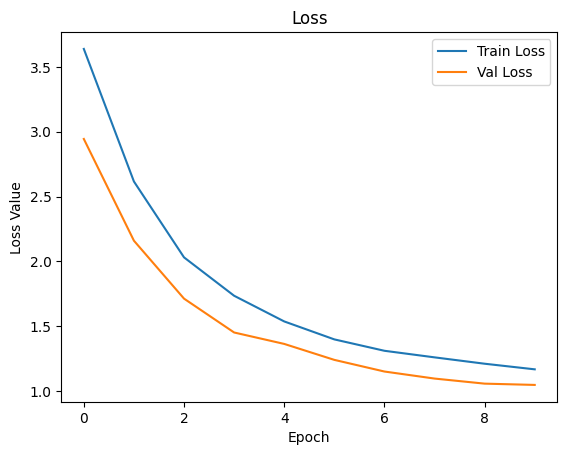

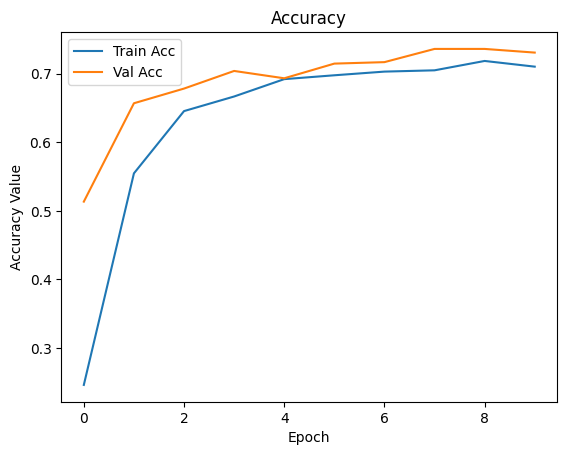

In [ ]:
# Plot the training and validation loss and accuracy
print(train_loss_history)
plt.plot(train_loss_history, label='Train Loss')
plt.plot(val_loss_history, label='Val Loss')
plt.legend()
plt.title('Loss')
plt.xlabel("Epoch")
plt.ylabel("Loss Value")

plt.figure()

plt.plot(train_acc_history, label='Train Acc')
plt.plot(val_acc_history, label='Val Acc')
plt.legend()
plt.title('Accuracy')
plt.xlabel("Epoch")
plt.ylabel("Accuracy Value")

plt.show()

In [ ]:
# take the best model from the training (Best validation loss)
model.load_state_dict(torch.load('model.pt'))

<All keys matched successfully>

#Step 8: Test the Model

In [ ]:
#unfreeze Paramters
for param in model.parameters():
  param.requires_grad = True

In [ ]:
def test(test_loader, model, criterion, use_cuda):

    # Initalize variables to determine accuracy
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(test_loader):
        # Use the GPUs
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        output = model(data)

        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

In [ ]:
test(testloader, model, criterion_transfer, use_cuda)


Test Accuracy: 89% (836/935)


In [ ]:
print(test_dataset.classes)

['Afghan', 'African Wild Dog', 'Airedale', 'American Hairless', 'American Spaniel', 'Basenji', 'Basset', 'Beagle', 'Bearded Collie', 'Bermaise', 'Bichon Frise', 'Blenheim', 'Bloodhound', 'Bluetick', 'Border Collie', 'Borzoi', 'Boston Terrier', 'Boxer', 'Bull Mastiff', 'Bull Terrier', 'Bulldog', 'Cairn', 'Chihuahua', 'Chinese Crested', 'Chow', 'Clumber', 'Cockapoo', 'Cocker', 'Collie', 'Corgi', 'Coyote', 'Dalmation', 'Dhole', 'Dingo', 'Doberman', 'Elk Hound', 'French Bulldog', 'German Sheperd', 'Golden Retriever', 'Great Dane', 'Great Perenees', 'Greyhound', 'Groenendael', 'Irish Spaniel', 'Irish Wolfhound', 'Japanese Spaniel', 'Komondor', 'Labradoodle', 'Labrador', 'Lhasa', 'Malinois', 'Maltese', 'Mex Hairless', 'Newfoundland', 'Pekinese', 'Pit Bull', 'Pomeranian', 'Poodle', 'Pug', 'Rhodesian', 'Rottweiler', 'Saint Bernard', 'Schnauzer', 'Scotch Terrier', 'Shar_Pei', 'Shiba Inu', 'Shih-Tzu', 'Siberian Husky', 'Vizsla', 'Yorkie']


In [ ]:
!pip install xlsxwriter


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
from sklearn.metrics import classification_report

def classification_report_display(test_loader, test_dataset, model, use_cuda, excel_filename):
    class_names = test_dataset.classes
    model.eval()
    y_true = []
    y_pred = []
    for batch_idx, (data, target) in enumerate(test_loader):
        # Use the GPUs
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        output = model(data)

        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]

        # append true and predicted labels
        y_true.extend(target.cpu().numpy())
        y_pred.extend(pred.cpu().numpy().flatten())

    report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)
    report_df = pd.DataFrame(report).transpose()

    # Export to Excel file
    report_df.to_excel(excel_filename, engine='xlsxwriter')
    print(classification_report(y_true, y_pred, target_names=class_names))
    print(f"Classification report exported to /content/sample_data/{excel_filename}")

In [ ]:
classification_report_display(testloader,test_dataset, model, use_cuda,"classificationReport.xlsx")

                   precision    recall  f1-score   support

           Afghan       0.92      1.00      0.96        11
 African Wild Dog       1.00      0.92      0.96        12
         Airedale       1.00      1.00      1.00        18
American Hairless       0.50      0.67      0.57         9
 American Spaniel       0.64      0.69      0.67        13
          Basenji       0.87      1.00      0.93        13
           Basset       0.94      1.00      0.97        17
           Beagle       1.00      0.94      0.97        16
   Bearded Collie       0.93      1.00      0.96        13
         Bermaise       1.00      1.00      1.00        11
     Bichon Frise       1.00      0.92      0.96        13
         Blenheim       0.91      1.00      0.95        10
       Bloodhound       0.94      1.00      0.97        15
         Bluetick       1.00      1.00      1.00        11
    Border Collie       0.87      0.93      0.90        14
           Borzoi       1.00      0.86      0.92       

# Step 9A: Test on Own Examples and Display
Images can be found in our repo in the folder test_Images/dogs

### Create a gradCam Activation Map

In [ ]:
class GradCamModel( nn.Module):
    def __init__(self, model):
        super().__init__()
        self.gradients = None
        self.tensorhook = []
        self.layerhook = []
        self.selected_out = None
        
        #PRETRAINED MODEL
        self.pretrained = model
        self.layerhook.append(self.pretrained.layer4.register_forward_hook(self.forward_hook()))
        
        for p in self.pretrained.parameters():
            p.requires_grad = True
    
    def activations_hook(self,grad):
        self.gradients = grad

    def get_act_grads(self):
        return self.gradients

    def forward_hook(self):
        def hook(module, inp, out):
            self.selected_out = out
            self.tensorhook.append(out.register_hook(self.activations_hook))
        return hook

    def forward(self,x):
        out = self.pretrained(x)
        return out, self.selected_out

In [ ]:
gcmodel = GradCamModel(model).to('cpu')

In [ ]:
def get_gradcam_tensor(img_path):
  img = imread(img_path) #'bulbul.jpg'
  img = resize(img, (224,224), preserve_range = True)
  img = np.expand_dims(img.transpose((2,0,1)),0)
  img /= 255.0
  mean = np.array([0.485, 0.456, 0.406]).reshape((1,3,1,1))
  std = np.array([0.229, 0.224, 0.225]).reshape((1,3,1,1))
  img = (img - mean)/std
  image_tensor = torch.from_numpy(img).to('cpu', torch.float32)
  return image_tensor, img


In [ ]:
def get_heat_maps(gcmodel, image_tensor,img):
  out, acts = gcmodel(image_tensor)
  loss = nn.CrossEntropyLoss()(out,torch.from_numpy(np.array([69])).to('cpu'))
  loss.backward()
  mean = np.array([0.485, 0.456, 0.406]).reshape((1,3,1,1))
  std = np.array([0.229, 0.224, 0.225]).reshape((1,3,1,1))
  grads = gcmodel.get_act_grads().detach().cpu()

  pooled_grads = torch.mean(grads, dim=[0,2,3]).detach().cpu()

  for i in range(acts.shape[1]):
      acts[:,i,:,:] *= pooled_grads[i]
  
  heatmap_j = torch.mean(acts, dim = 1).squeeze()
  heatmap_j_max = heatmap_j.max(axis = 0)[0]
  heatmap_j /= heatmap_j_max
  heatmap_j = heatmap_j.detach().cpu().numpy()
  heatmap_j = resize(heatmap_j,(224,224),preserve_range=True)

  cmap = mpl.colormaps.get_cmap('jet')
  heatmap_j2 = cmap(heatmap_j,alpha = 0.2)
  fig, axs = plt.subplots(1,1,figsize = (5,5))
  axs.imshow((img*std+mean)[0].transpose(1,2,0))
  axs.imshow(heatmap_j2)
  plt.show()
  print("Grad Cam heat Map")
  heatmap_j3 = resize(heatmap_j,(224,224,3),preserve_range=True)
  heatmap_j3 = (heatmap_j3 > 0.75)
  fig, axs = plt.subplots(1,1,figsize = (5,5))
  axs.imshow(((img*std+mean)[0].transpose(1,2,0))*heatmap_j3)
  plt.show()
  print("Grad Cam feature Map")
 

In [ ]:
# CPU or GPU
device = torch.device("cuda:0" if use_cuda else "cpu")

# Load the trained model 'model.pt'
model.load_state_dict(torch.load('model.pt', map_location='cpu'))

<All keys matched successfully>

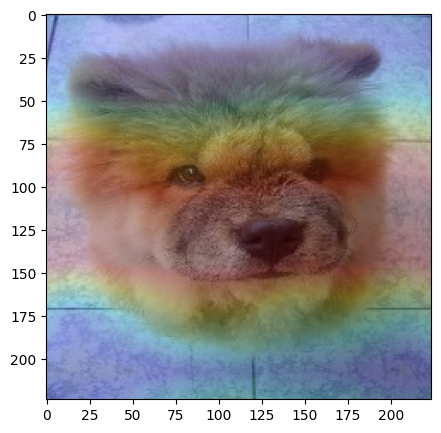

Grad Cam heat Map


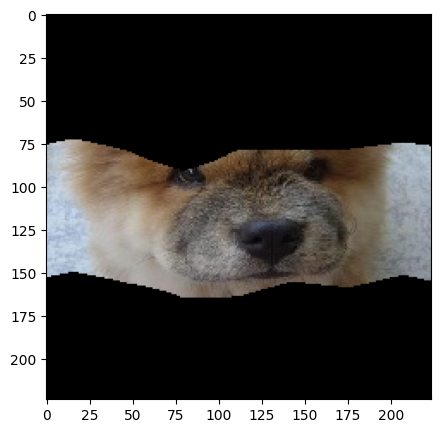

Grad Cam feature Map


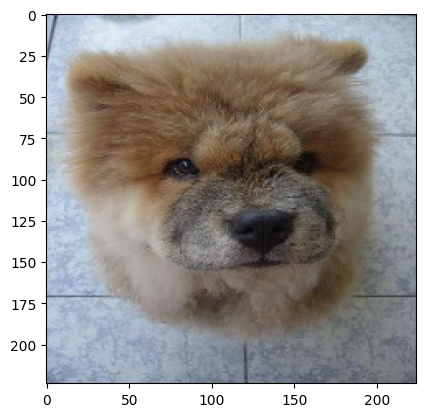

Actual Breed: Chow, 	 prediction breed: Chow


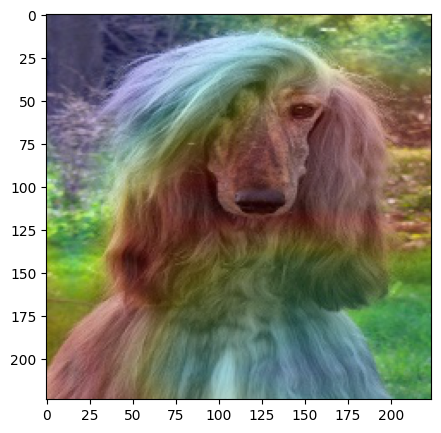

Grad Cam heat Map


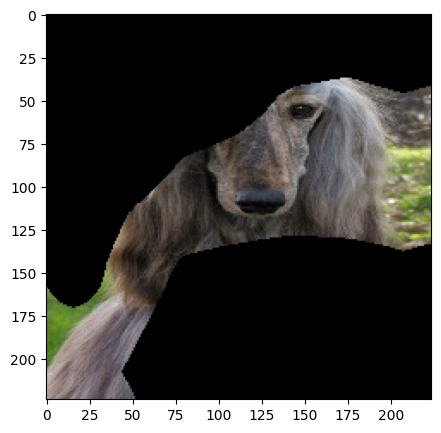

Grad Cam feature Map


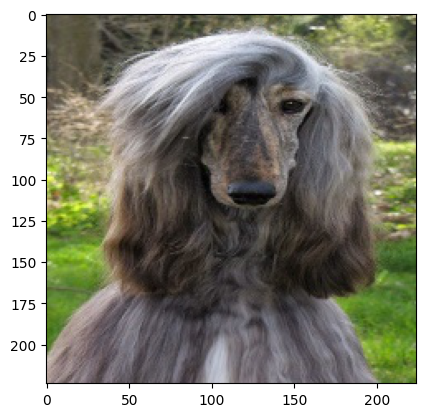

Actual Breed: Afghan, 	 prediction breed: Afghan


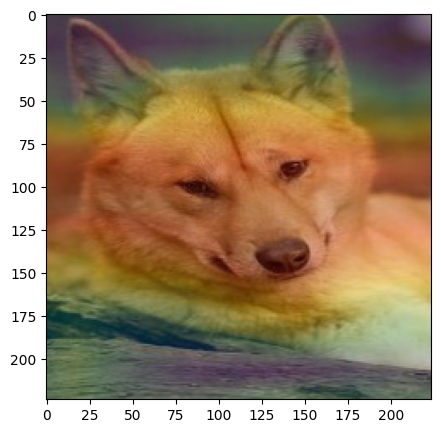

Grad Cam heat Map


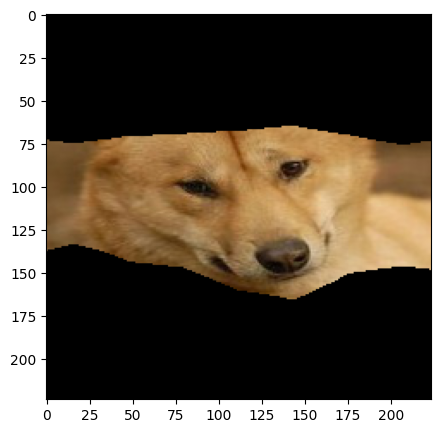

Grad Cam feature Map


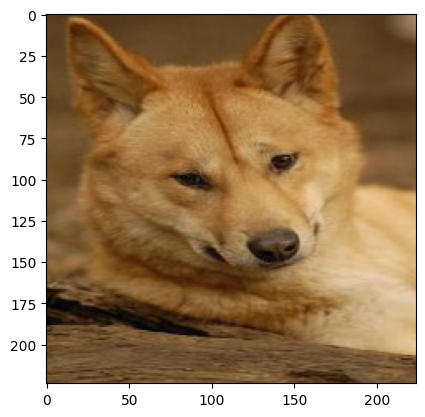

Actual Breed: Dingo, 	 prediction breed: Dingo


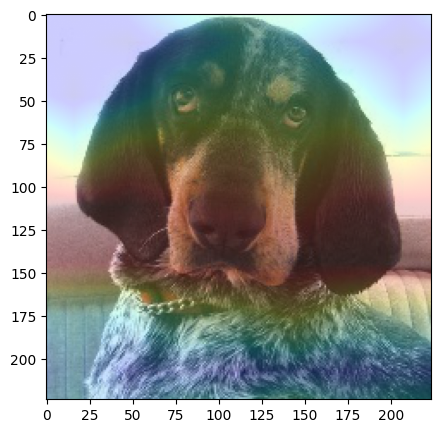

Grad Cam heat Map


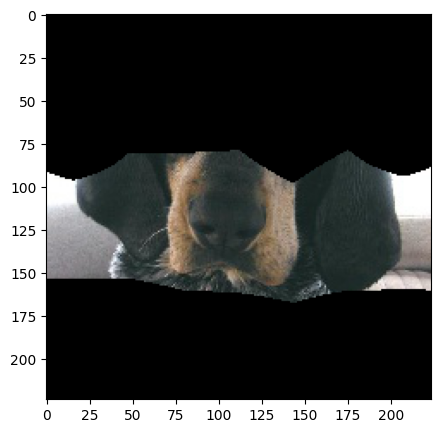

Grad Cam feature Map


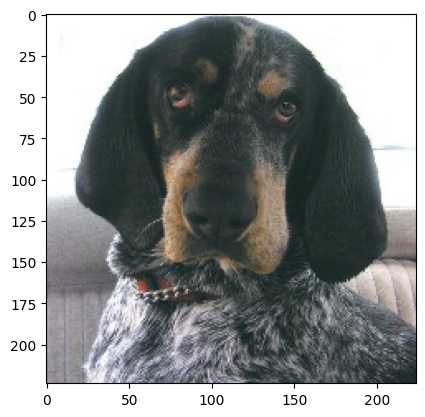

Actual Breed: Bluetick, 	 prediction breed: Bluetick


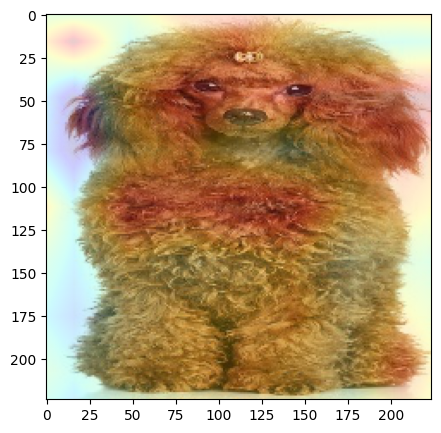

Grad Cam heat Map


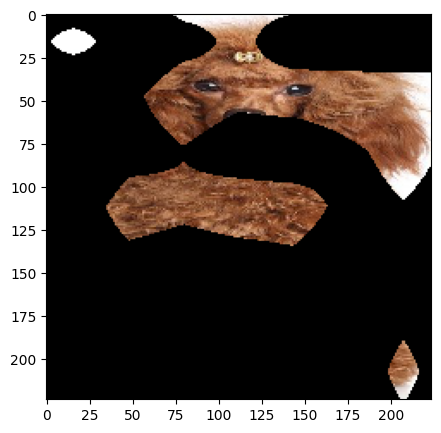

Grad Cam feature Map


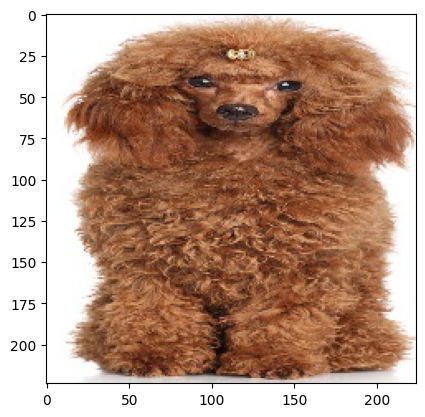

Actual Breed: Poodle_02, 	 prediction breed: Poodle


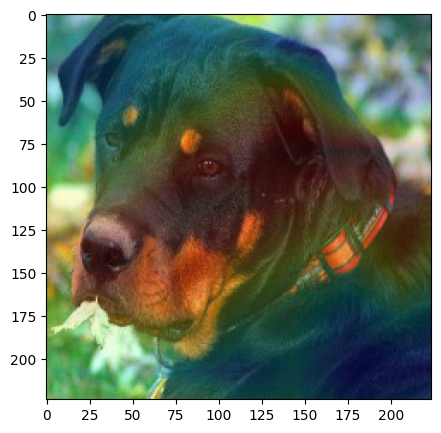

Grad Cam heat Map


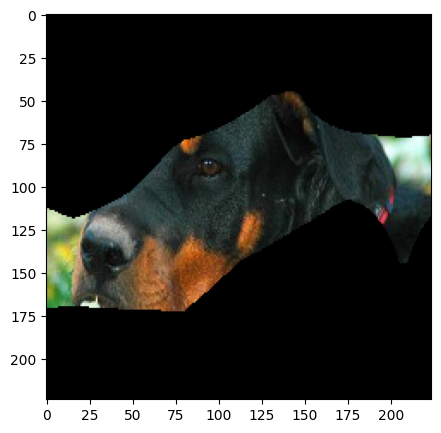

Grad Cam feature Map


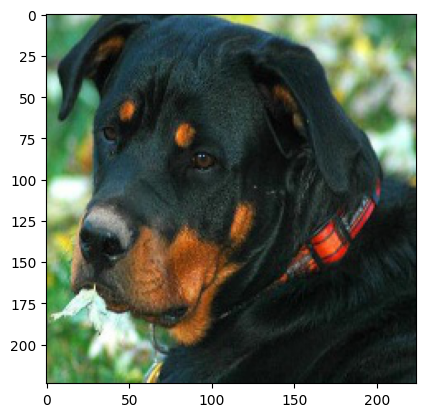

Actual Breed: Rottweiler, 	 prediction breed: Rottweiler


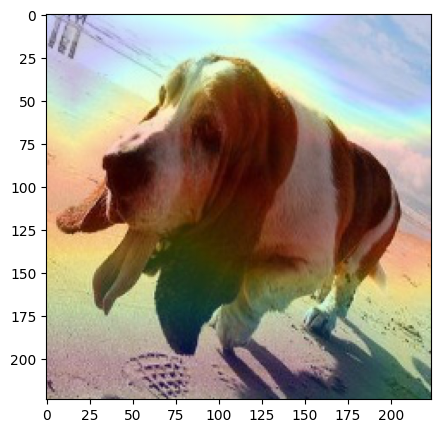

Grad Cam heat Map


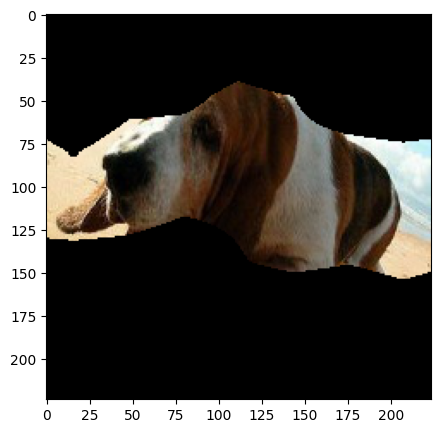

Grad Cam feature Map


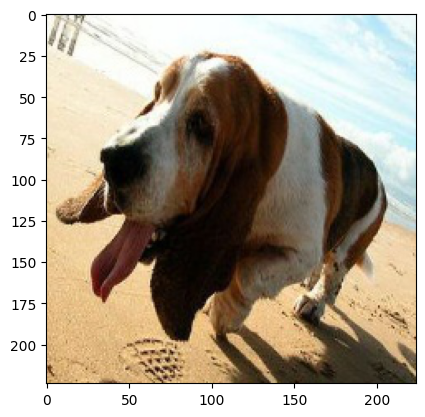

Actual Breed: Basset, 	 prediction breed: Basset


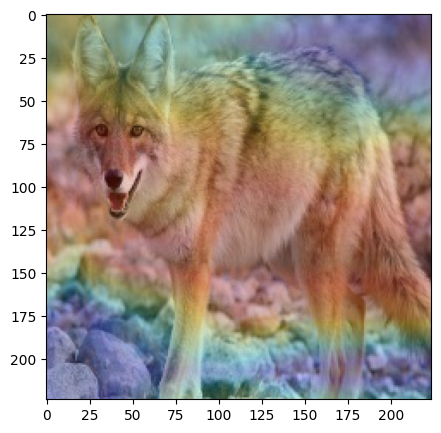

Grad Cam heat Map


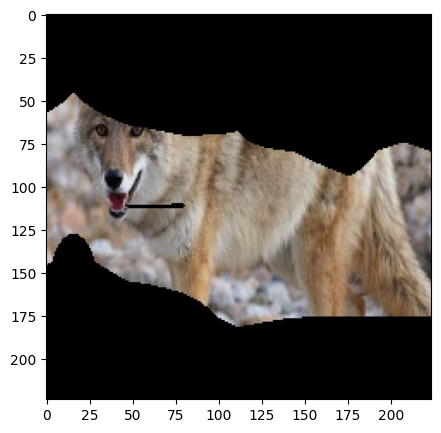

Grad Cam feature Map


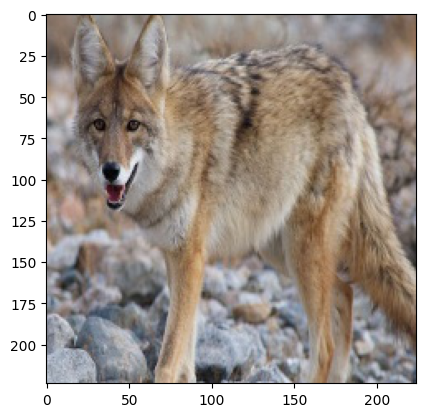

Actual Breed: Coyote, 	 prediction breed: Coyote


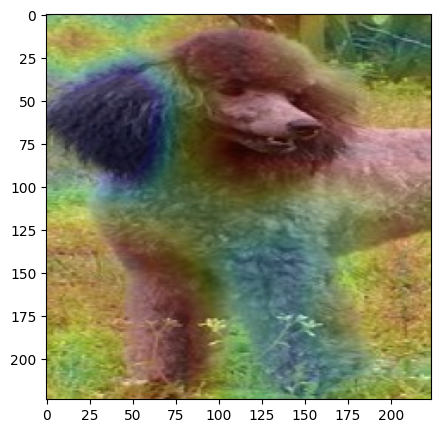

Grad Cam heat Map


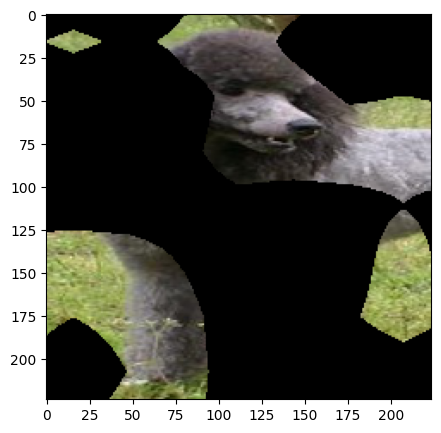

Grad Cam feature Map


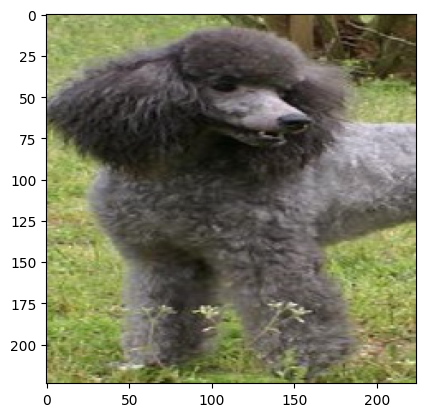

Actual Breed: Poodle, 	 prediction breed: Poodle


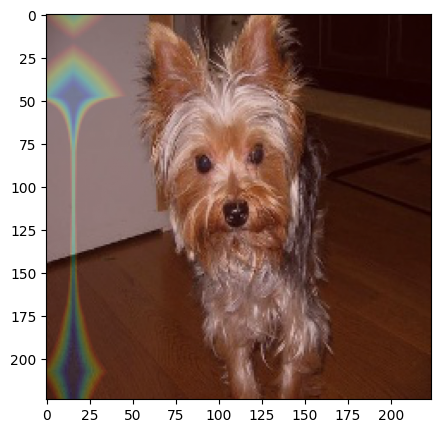

Grad Cam heat Map


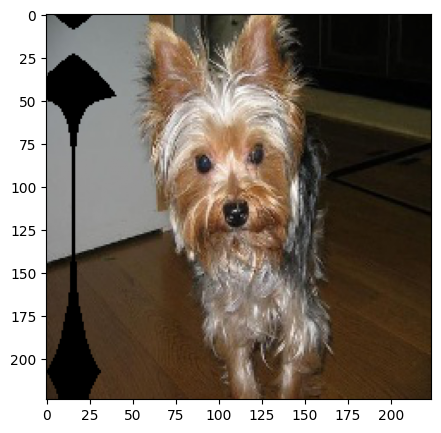

Grad Cam feature Map


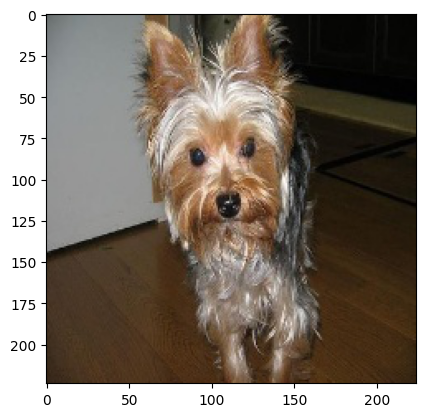

Actual Breed: Yorkie, 	 prediction breed: Yorkie


In [ ]:

class_names = [item[:] for item in train_dataset.classes]

def load_input_image(img_path):  
    #Opens the image using the PIL Image module and convert it to RGB mode  
    image = Image.open(img_path).convert('RGB')
    #Defines a series of image transformations using the torchvision.transforms.Compose() method
    prediction_transform = transforms.Compose([transforms.Resize(size=(224, 224)),
                                               transforms.ToTensor(), 
                                               transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                                    std=[0.229, 0.224, 0.225])])
    #Applies the defined transformations to the input image
    image = prediction_transform(image)[:3,:,:].unsqueeze(0)
    #Returns the transformed image as a tensor
    return image

#Defines a function to predict the breed of a dog
def predict_breed_transfer(model, class_names, img_path):
    # load the image and return the predicted breed
    img = load_input_image(img_path)
    img_show = Image.open(img_path)
    gcmodel = GradCamModel(model).to('cpu')
    image_tensor,cam_image = get_gradcam_tensor(img_path)
    get_heat_maps(gcmodel,image_tensor,cam_image)
    plt.imshow(img_show)
    plt.show()
    for h in gcmodel.layerhook:
      h.remove()
    for h in gcmodel.tensorhook:
      h.remove()

    #Move the model to the CPU and set it to evaluation mode
    model = model.cpu()
    model.eval()
    idx = torch.argmax(model(img))
    return class_names[idx]

#Loop through each of the images in the test images folder and run the prediction on them
for img_file in os.listdir('/tmp/ENEL-645-Project-Dog-Classifier-main/test_Images/correct_dogs'):
    img_path = os.path.join('/tmp/ENEL-645-Project-Dog-Classifier-main/test_Images/correct_dogs', img_file)
    prediction = predict_breed_transfer(model, class_names, img_path)
    breed_name = img_path.split('/')[-1].split('.')[0]
    print("Actual Breed: {0}, \t prediction breed: {1}".format(breed_name, prediction,))



# Step 10: Get Incorrect Model Predictions

Define functions

In [ ]:
import torch.nn.functional as F

# function to get all incorrectly predicted breeds, as well as percentage guesses from softmax probabilities
def test_incorrect_with_percents(test_loader, model, criterion, use_cuda):
    # Initialize variables to determine accuracy
    incorrect_images = []
    model.eval()

    if use_cuda:
        model.cuda()

    incorrect_guesses = []

    for batch_idx, (data, target) in enumerate(test_loader):
        # Use the GPUs
        if use_cuda:
            data, target = data.cuda(), target.cuda()
            model.cuda()
        output = model(data)
        
        # Calculate the Softmax probabilities
        probabilities = F.softmax(output, dim=1)
        
        # Sort the probabilities in descending order
        sorted_probs, sorted_idxs = torch.sort(probabilities, descending=True)
        
        # Extract the class names and their respective probabilities
        class_probs = []
        for i in range(len(target)):
            class_probs.append([])
            for j in range(3):
                class_probs[i].append((class_names[sorted_idxs[i][j]], sorted_probs[i][j].item()))

        # Convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]

        # Compare predictions to true label
        incorrect_idx = np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy() == 0
        incorrect_images.extend(data[incorrect_idx])
        for i in range(len(incorrect_idx)):
            if incorrect_idx[i]:
                actual_class = class_names[target.data[i]]
                predicted_class = class_names[pred[i]]
                incorrect_guesses.append((actual_class, predicted_class, class_probs[i]))

    return incorrect_images, incorrect_guesses

# function to show images, with specific formatting for soft max probabilities
def show_images_cpu(inp,labels):
  inp = inp.cpu().numpy().transpose((1, 2, 0))
  inp = inp * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
  inp = np.clip(inp, 0, 1)
  
  fig = plt.figure(figsize=(5,5))
  plt.axis('off')
  plt.imshow(inp)
  plt.pause(0.001)
  print("Actual Breed: {}".format(labels[0]))
  print("Predicted Breed: {}".format(labels[1]))

  output_string = ""

  # Iterate over the class probabilities and create a formatted string
  for i in range(len(labels[2])):
      class_name = labels[2][i][0]
      class_prob = round(labels[2][i][1]*100,1)
      output_string += f"{class_name}: {class_prob}%, "

  # Remove the trailing comma and space
  output_string = output_string[:-2]

  print("Predicted Breeds by Percentage: {}".format(output_string))


Evaluate incorrect images and print out 10 sample images with probabilities

<class 'torch.Tensor'>


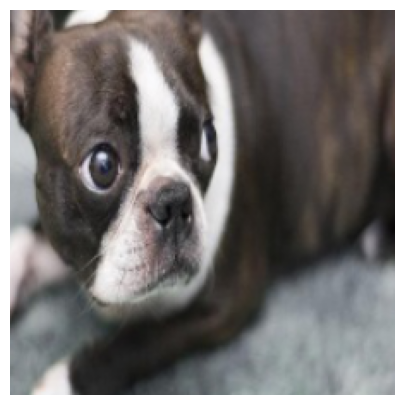

Actual Breed: Bulldog
Predicted Breed: Boston Terrier
Predicted Breeds by Percentage: Boston Terrier: 72.9%, Bulldog: 25.0%, French Bulldog: 1.2%
<class 'torch.Tensor'>


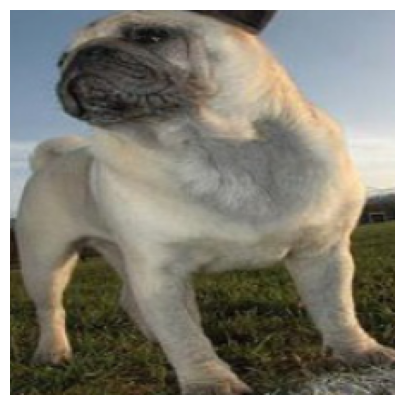

Actual Breed: Pug
Predicted Breed: Bull Mastiff
Predicted Breeds by Percentage: Bull Mastiff: 21.6%, Pug: 15.7%, Great Dane: 12.6%
<class 'torch.Tensor'>


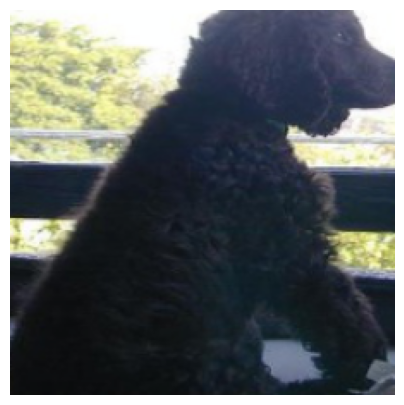

Actual Breed: Irish Spaniel
Predicted Breed: American Spaniel
Predicted Breeds by Percentage: American Spaniel: 51.6%, Irish Spaniel: 37.0%, Groenendael: 3.6%
<class 'torch.Tensor'>


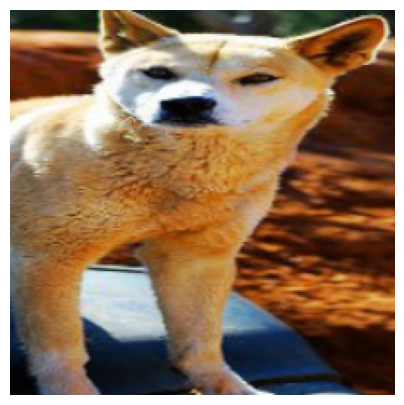

Actual Breed: Dingo
Predicted Breed: Shiba Inu
Predicted Breeds by Percentage: Shiba Inu: 63.2%, Dingo: 26.3%, Basenji: 1.7%
<class 'torch.Tensor'>


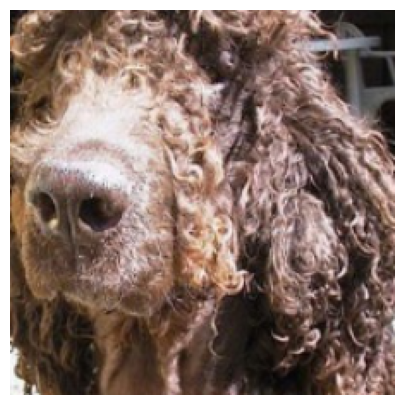

Actual Breed: Irish Spaniel
Predicted Breed: American Spaniel
Predicted Breeds by Percentage: American Spaniel: 51.8%, Irish Spaniel: 42.5%, Poodle: 1.7%
<class 'torch.Tensor'>


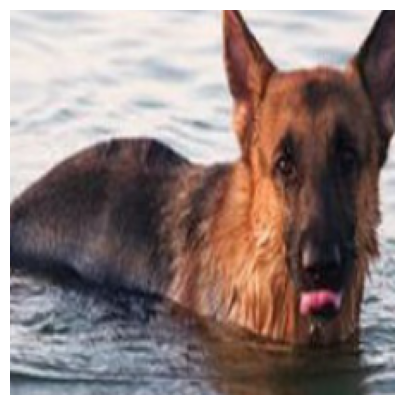

Actual Breed: German Sheperd
Predicted Breed: Malinois
Predicted Breeds by Percentage: Malinois: 27.0%, German Sheperd: 24.5%, Corgi: 7.6%
<class 'torch.Tensor'>


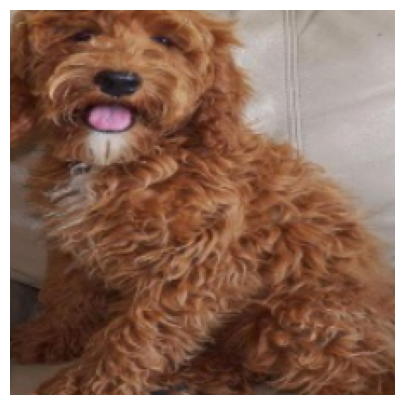

Actual Breed: Cockapoo
Predicted Breed: Labradoodle
Predicted Breeds by Percentage: Labradoodle: 55.2%, Cockapoo: 38.5%, Airedale: 3.1%
<class 'torch.Tensor'>


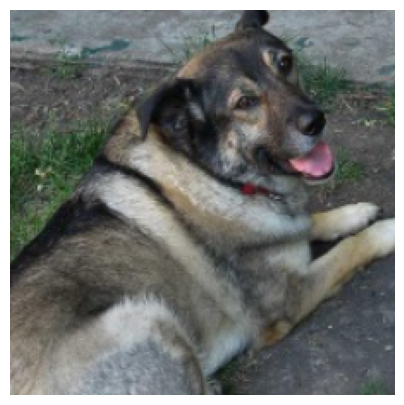

Actual Breed: Elk Hound
Predicted Breed: German Sheperd
Predicted Breeds by Percentage: German Sheperd: 54.8%, Elk Hound: 30.6%, Malinois: 3.7%
<class 'torch.Tensor'>


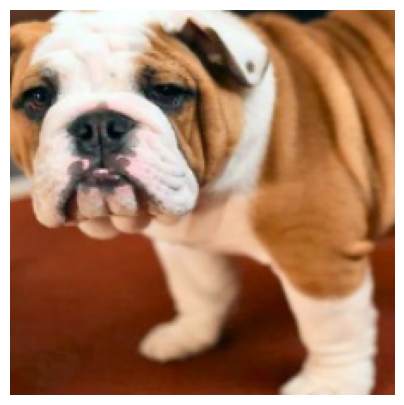

Actual Breed: Bulldog
Predicted Breed: Boxer
Predicted Breeds by Percentage: Boxer: 38.9%, Bulldog: 27.8%, Bull Mastiff: 7.6%
<class 'torch.Tensor'>


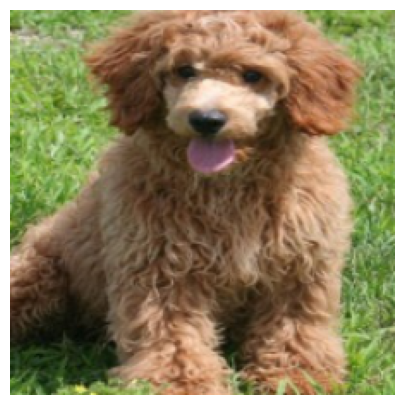

Actual Breed: Poodle
Predicted Breed: Labradoodle
Predicted Breeds by Percentage: Labradoodle: 52.5%, Cockapoo: 24.6%, Poodle: 15.9%


In [ ]:
incorrect_images, incorrect_guesses = test_incorrect_with_percents(testloader, model, criterion_transfer, use_cuda)

for i in range(10):
  print(type(incorrect_images[i]))
  show_images_cpu(incorrect_images[i],incorrect_guesses[i])

Now we take the incorrect guesses array and sum it up to find the breeds that the model had the most difficulty classifying

In [ ]:
import pandas as pd
from google.colab import files

df = pd.DataFrame(incorrect_guesses)
df.columns = ['Actual Class','Predicted Class','Probabilities']
df.to_csv('output.csv', encoding = 'utf-8-sig') 
files.download('output.csv')
df2 = df.drop(['Predicted Class','Probabilities'], axis=1)
counts = df2['Actual Class'].value_counts()
new_df = pd.DataFrame({'Actual Class': counts.index, 'Count': counts.values})

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

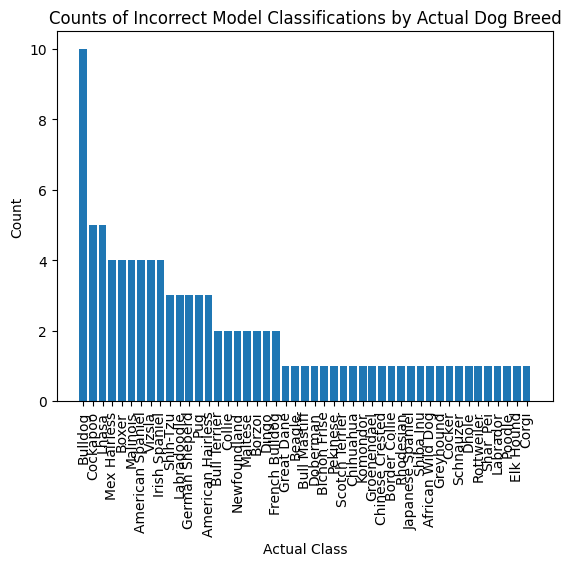

In [ ]:
# create a bar plot
plt.bar(new_df['Actual Class'], new_df['Count'])

# set the title and axis labels
plt.title('Counts of Incorrect Model Classifications by Actual Dog Breed')
plt.xlabel('Actual Class')
plt.ylabel('Count')
plt.xticks(rotation='vertical')


# display the plot
plt.show()

## Dog Grad Cams that were wrong

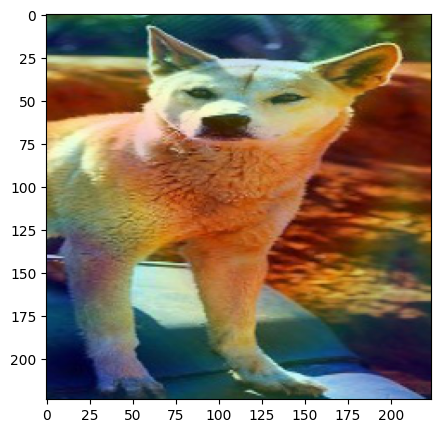

Grad Cam heat Map


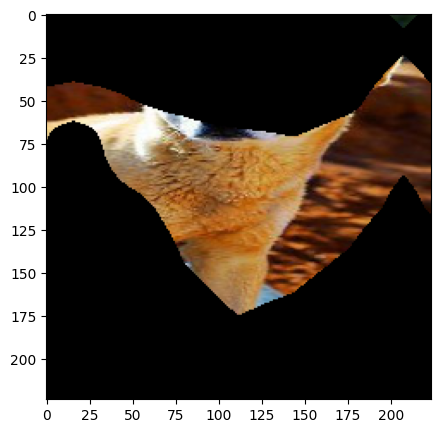

Grad Cam feature Map


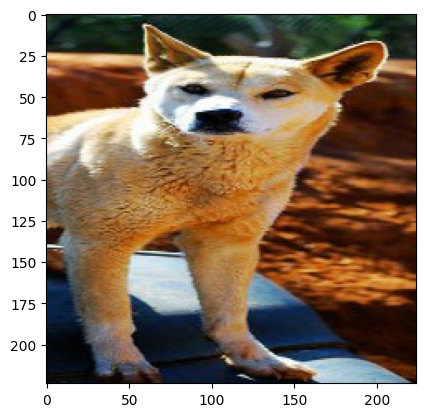

Actual Breed: Dingo, 	 prediction breed: Shiba Inu


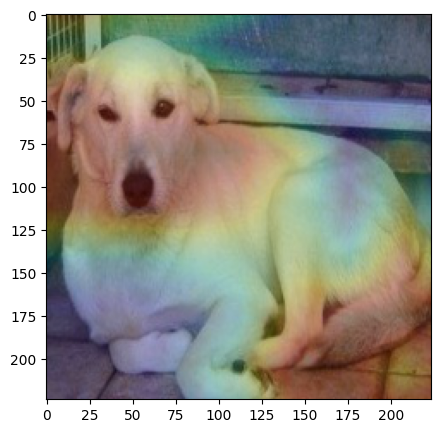

Grad Cam heat Map


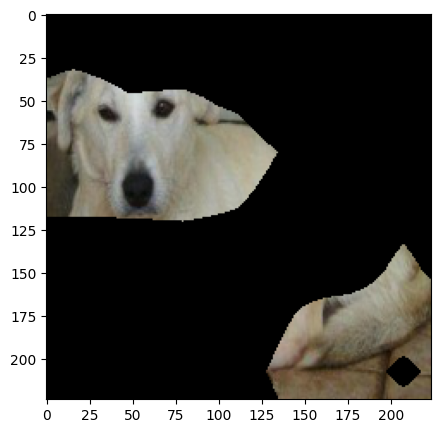

Grad Cam feature Map


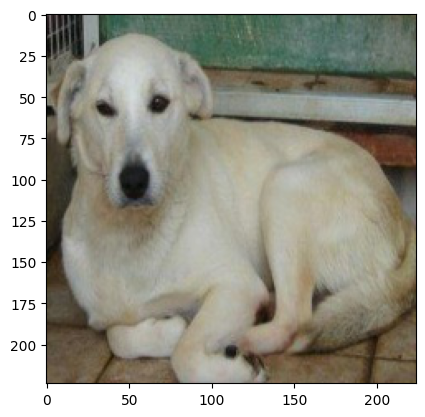

Actual Breed: Labrador, 	 prediction breed: Greyhound


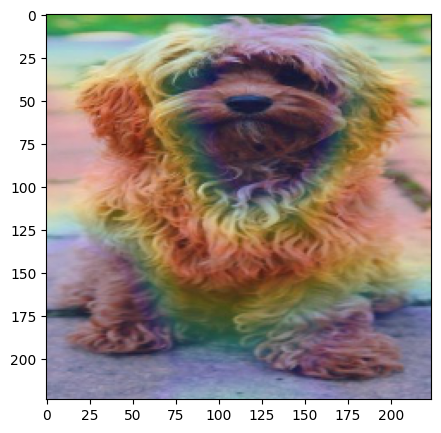

Grad Cam heat Map


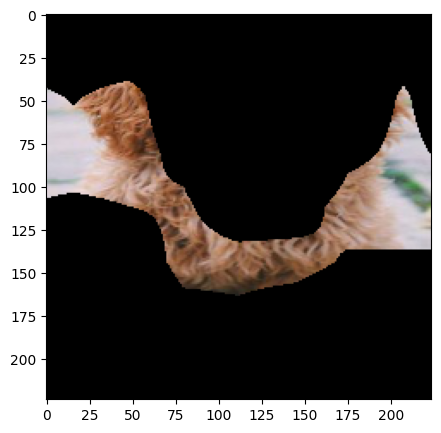

Grad Cam feature Map


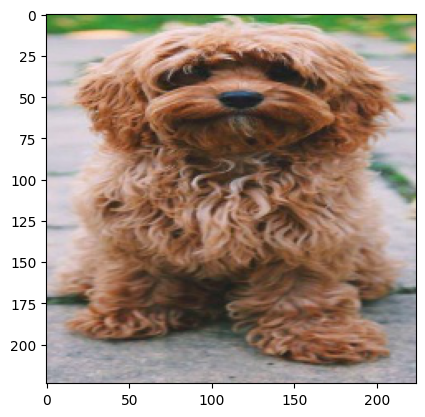

Actual Breed: Cockapoo, 	 prediction breed: Cockapoo


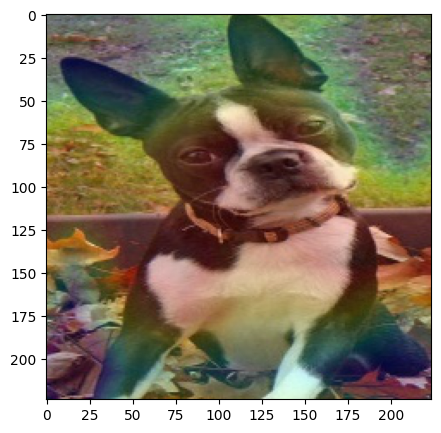

Grad Cam heat Map


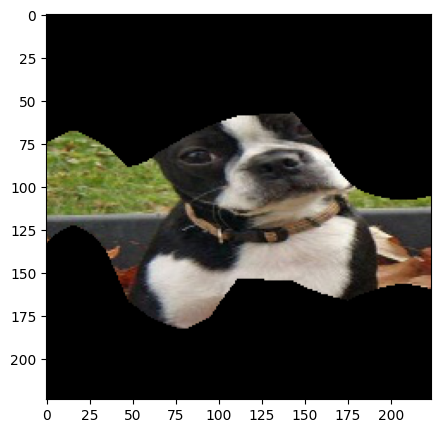

Grad Cam feature Map


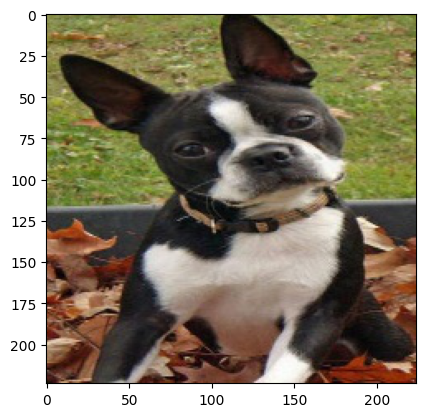

Actual Breed: 02, 	 prediction breed: Boston Terrier


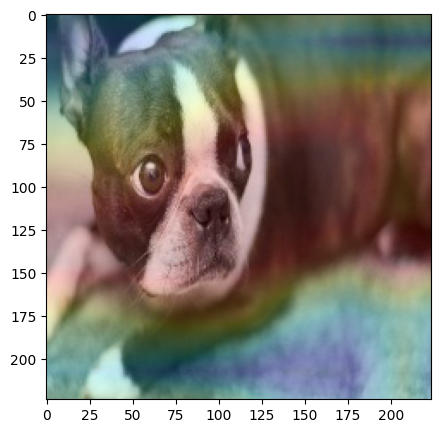

Grad Cam heat Map


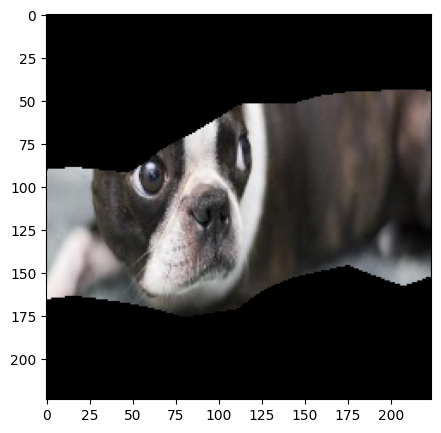

Grad Cam feature Map


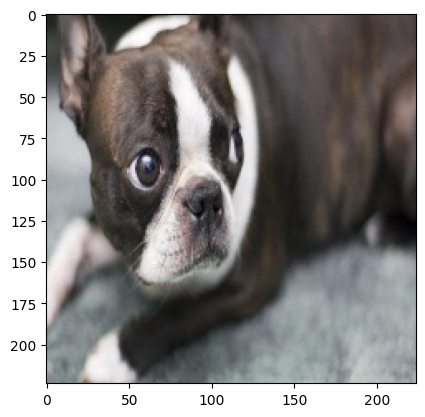

Actual Breed: Bulldog, 	 prediction breed: Boston Terrier


In [ ]:
class_names = [item[:] for item in train_dataset.classes]

for img_file in os.listdir('/tmp/ENEL-645-Project-Dog-Classifier-main/test_Images/incorrect_dogs'):
   if img_file.endswith('.jpg'):
      img_path = os.path.join('/tmp/ENEL-645-Project-Dog-Classifier-main/test_Images/incorrect_dogs', img_file)
      prediction = predict_breed_transfer(model, class_names, img_path)
      breed_name = img_path.split('/')[-1].split('.')[0]
      print("Actual Breed: {0}, \t prediction breed: {1}".format(breed_name, prediction,))

## Incorrect breed predictions

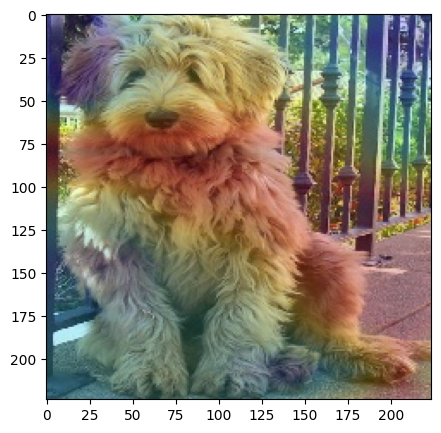

Grad Cam heat Map


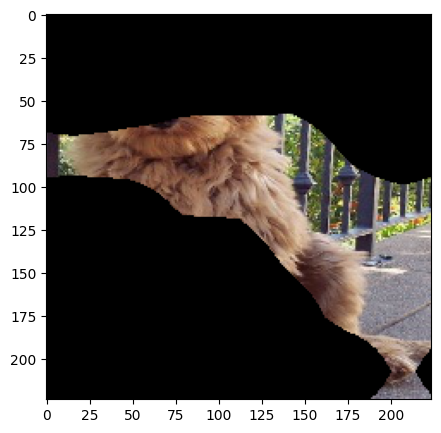

Grad Cam feature Map


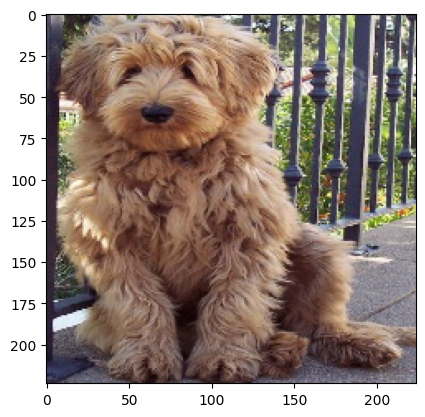

Actual Breed: Labradoodle, 	


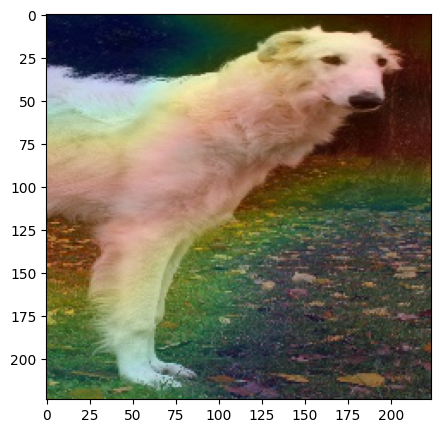

Grad Cam heat Map


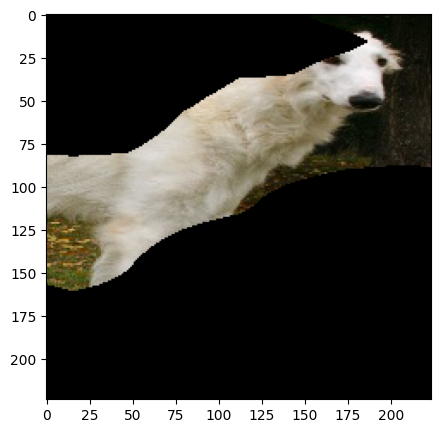

Grad Cam feature Map


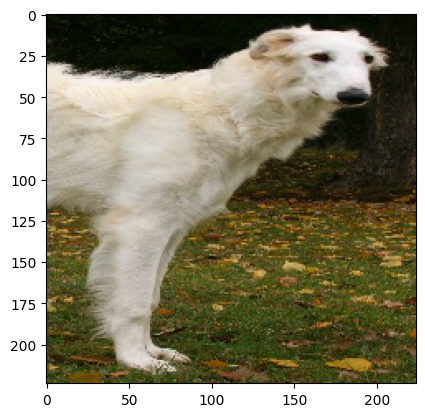

Actual Breed: Borzoi, 	


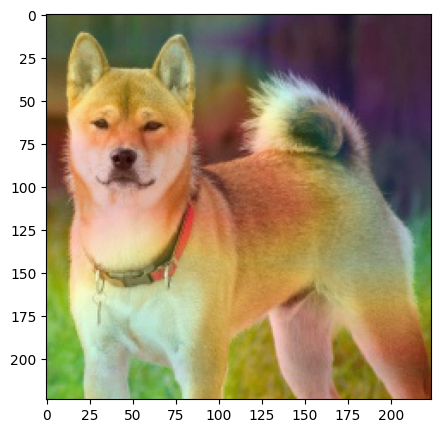

Grad Cam heat Map


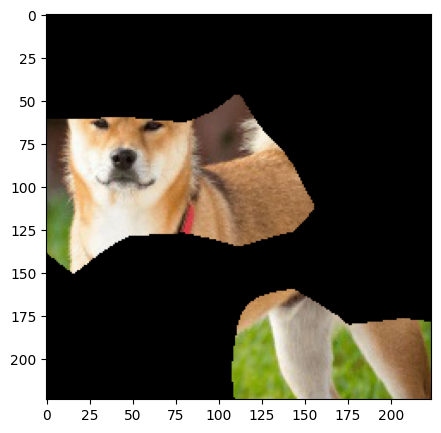

Grad Cam feature Map


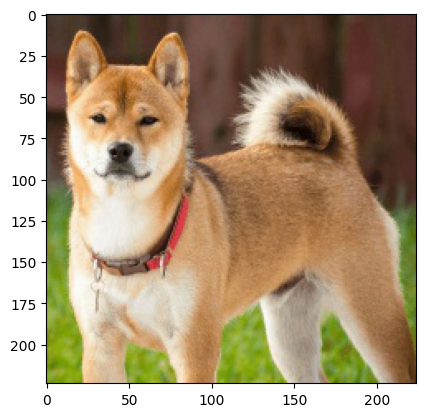

Actual Breed: Shiba Inu, 	


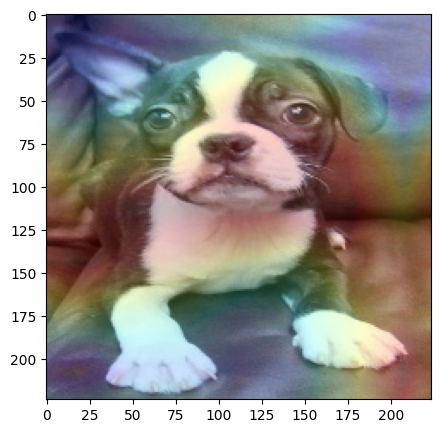

Grad Cam heat Map


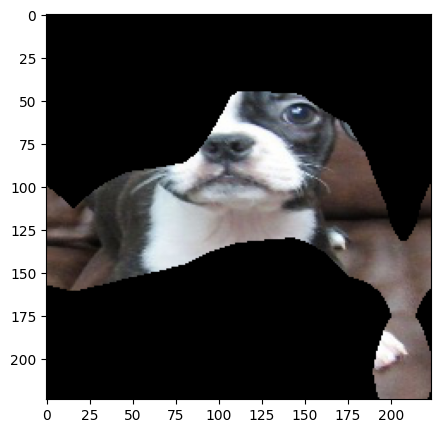

Grad Cam feature Map


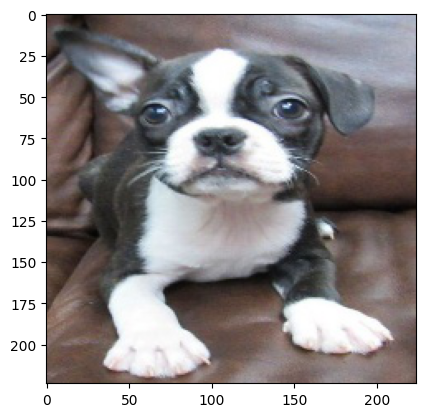

Actual Breed: Bulldog, 	


In [ ]:
for img_file in os.listdir('/tmp/ENEL-645-Project-Dog-Classifier-main/test_Images/compare_breeeds'):
    img_path = os.path.join('/tmp/ENEL-645-Project-Dog-Classifier-main/test_Images/compare_breeeds', img_file)
    prediction = predict_breed_transfer(model, class_names, img_path)
    breed_name = img_path.split('/')[-1].split('.')[0]
    print("Actual Breed: {0}, \t".format(breed_name))